In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# Import the necessary libraries
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd 
import scanpy as sc
import igraph


import time
from pathlib import Path
import torch
import Concord as ccd
import scFates as scf 
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

/opt/anaconda3/envs/Concord/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
# Import data

# ../.../..._ZJ.h5ad merges the cell types in the intestine_dev dataset: MSC, Epithelial, Endothelial, Mesenchymal.
adata = sc.read_h5ad('../data/intestine_dev/intestine_Huycke_ZJ.h5ad')
adata_raw = adata.copy()

In [10]:
proj_name = "Huycke_benchmarking_cell_cycle"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
seed = 0
ccd.ul.set_seed(seed)

file_suffix = f"{time.strftime('%b%d-%H%M')}"

# Concord latent shows both global and local information of the intestine dataset by UMAP (Panel A)

In [14]:
# print adata obs and var
print(adata.obs.columns)
print(adata.obsm.keys())

Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'RNA_snn_res.0.5',
       'seurat_clusters', 'PercentMito', 'RNA_snn_res.1', 'LaneID', 'MULTI',
       'SinDubNeg', 'Age', 'Mouse', 'SegPos', 'RNA_snn_res.5', 'nCount_SCT',
       'nFeature_SCT', 'SCT_snn_res.1', 'Age_Mouse', 'Age_Pos',
       'CellType_Coarse', 'SCT_snn_res.0.8', 'Classification', 'MouseAge',
       'SegmentPos', 'MouseAge_combined', 'batch', 'mes_subtype', 'cell_type',
       'epi_subtype', 'mes_BN', 'tcf_signaling_response_wnt_score',
       'epi_wnt_group', 'MitoFraction', 'seg_classify', 'S_score', 'G2M_score',
       'phase', 'dropout_est', 'PC1', 'Concord1', 'PC2', 'Concord2', 'PC3',
       'Concord3', 'pseudotime_order', 'refined_phase', 'cell_type_general',
       't', 'seg', 'edge', 't_sd', 'milestones', 't_reverse', 't_scFates'],
      dtype='object')
KeysView(AxisArrays with keys: Concord, Concord_PCA, Concord_UMAP, Concord_UMAP_3D, Concord_bottom, Concord_bottom_PCA_ct, Concord_top, Concord_top_PCA, X_R, X

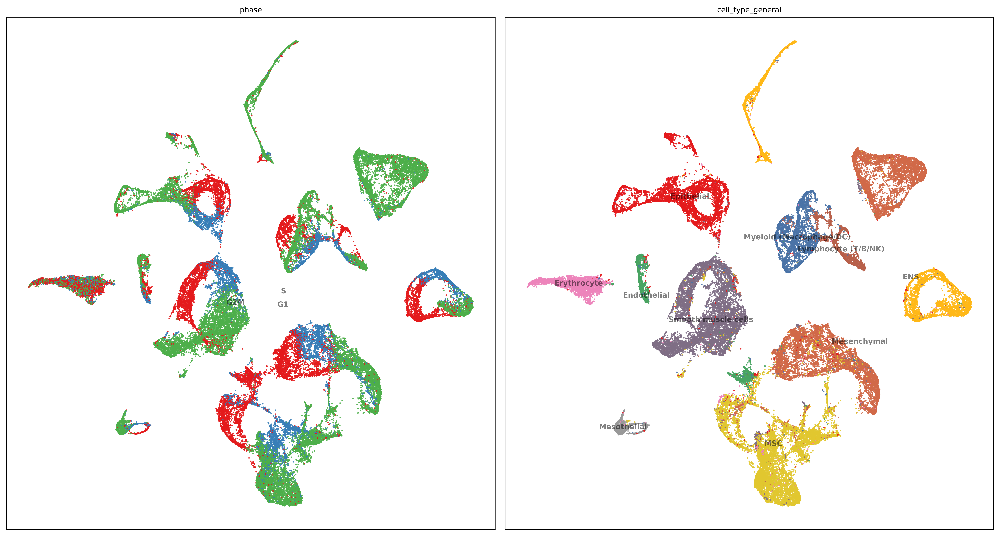

In [12]:
show_emb = 'Concord_UMAP'

show_cols = ['phase', 'cell_type_general']

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(15,8), dpi=600, ncols=2, font_size=8, point_size=10, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)

# Concord UMAP of each cell type indicates cell cycle related loop structure (Panel B)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


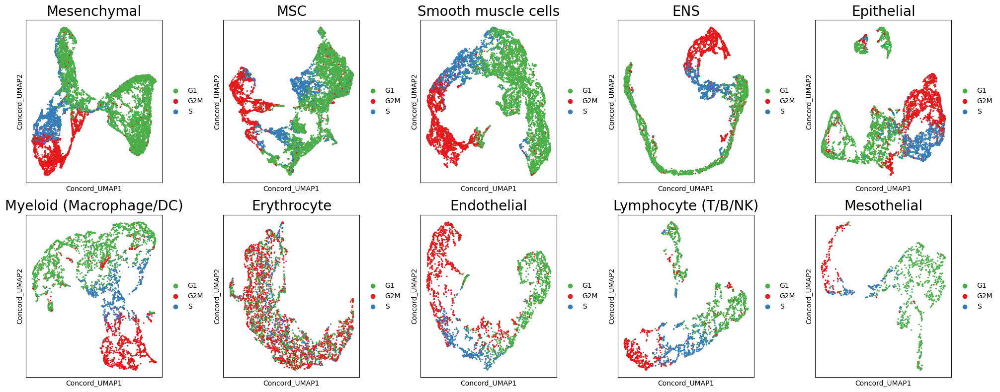

In [17]:
show_emb = 'Concord_UMAP'

show_cols = ['phase']

# check the UMAP results in Concord latent for the 10 cell types

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
    
    cell_type = adata.obs['cell_type_general'].value_counts().index[i]
    adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()

    # run UMAP in Concord latent space
    ccd.ul.run_umap(adata_sub, source_key='Concord', result_key='Concord_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)

    sc.pl.embedding(adata_sub, basis='Concord_UMAP', color='phase', ax=axs[i], show=False, s=20)

    axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir / f"embeddings_{show_emb}_per_cell_type_{file_suffix}.png", dpi=600)
plt.show()

In [19]:
# further quantitative analysis using Betti number

# PCA space of the cell cycle gene space (Panel C)

In [22]:
# Define cell cycle marker genes of mouse
s_genes = [
    'MCM5', 'PCNA', 'TYMS', 'FEN1', 'MCM2', 'MCM4', 'RRM1', 'UNG', 'GINS2', 'MCM6', 'CDCA7',
    'DTL', 'PRIM1', 'UHRF1', 'MLF1IP', 'HELLS', 'RFC2', 'RPA2', 'NASP', 'RAD51AP1', 'GMNN',
    'WDR76', 'SLBP', 'CCNE2', 'UBR7', 'POLD3', 'MSH2', 'ATAD2', 'RAD51', 'RRM2', 'CDC45',
    'CDC6', 'EXO1', 'TIPIN', 'DSCC1', 'BLM', 'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'CHAF1B',
    'BRIP1', 'E2F8'
]
g2m_genes = [
    'HMGB2', 'CDK1', 'NUSAP1', 'UBE2C', 'BIRC5', 'TPX2', 'TOP2A', 'NDC80', 'CKS2', 'NUF2',
    'CKS1B', 'MKI67', 'TMPO', 'CENPF', 'TACC3', 'FAM64A', 'SMC4', 'CCNB2', 'CKAP2L', 'CKAP2',
    'AURKB', 'BUB1', 'KIF11', 'ANP32E', 'TUBB4B', 'GTSE1', 'KIF20B', 'HJURP', 'CDCA3', 'HN1',
    'CDC20', 'TTK', 'CDC25C', 'KIF2C', 'RANGAP1', 'NCAPD2', 'DLGAP5', 'CDCA2', 'CDCA8', 'ECT2',
    'KIF23', 'HMMR', 'AURKA', 'PSRC1', 'ANLN', 'LBR', 'CKAP5', 'CENPE', 'CTCF', 'NEK2', 'G2E3',
    'GAS2L3', 'CBX5', 'CENPA'
]

s_genes = ccd.ul.get_mouse_genes(s_genes)
g2m_genes = ccd.ul.get_mouse_genes(g2m_genes)
cc_genes = s_genes + g2m_genes

# get the cc_genes that are in adata.var
cc_genes = [gene for gene in cc_genes if gene in adata.var_names]

adata_cc = adata[:, cc_genes].copy()

Concord - INFO - Processed 43 human genes to mouse orthologs.
Concord - INFO - Processed 54 human genes to mouse orthologs.


In [24]:
# run PCA on the adata_cc
ccd.ul.run_pca(adata_cc, source_key = 'X', result_key='cc_PCA', n_pc=30, random_state=seed)

# run UMAP on the adata_cc
ccd.ul.run_umap(adata_cc, source_key = 'cc_PCA', result_key='cc_UMAP', random_state=seed)

Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']


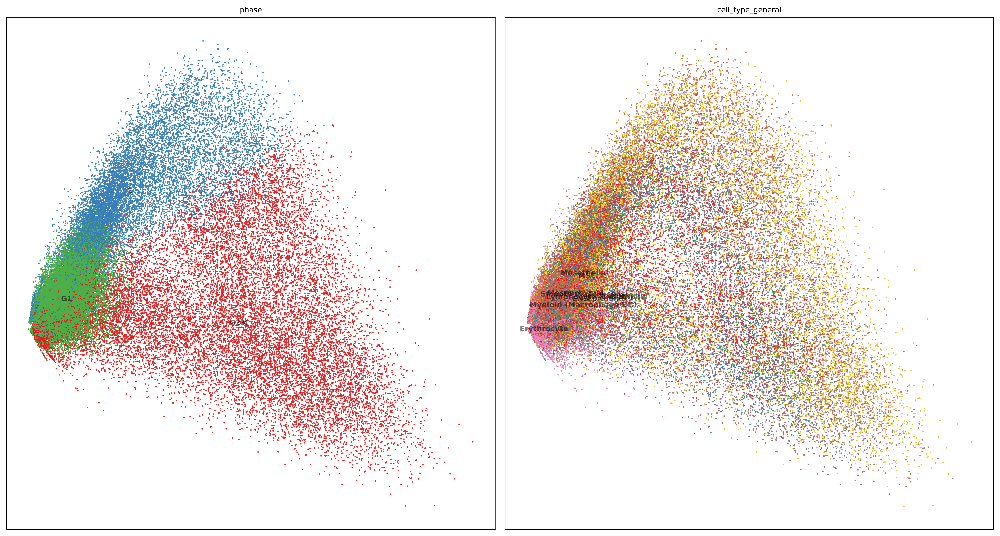

In [27]:
show_emb = 'cc_PCA'

show_cols = ['phase', 'cell_type_general']

ccd.pl.plot_embedding(
    adata_cc, show_emb, show_cols, figsize=(15,8), dpi=600, ncols=2, font_size=8, point_size=10, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)

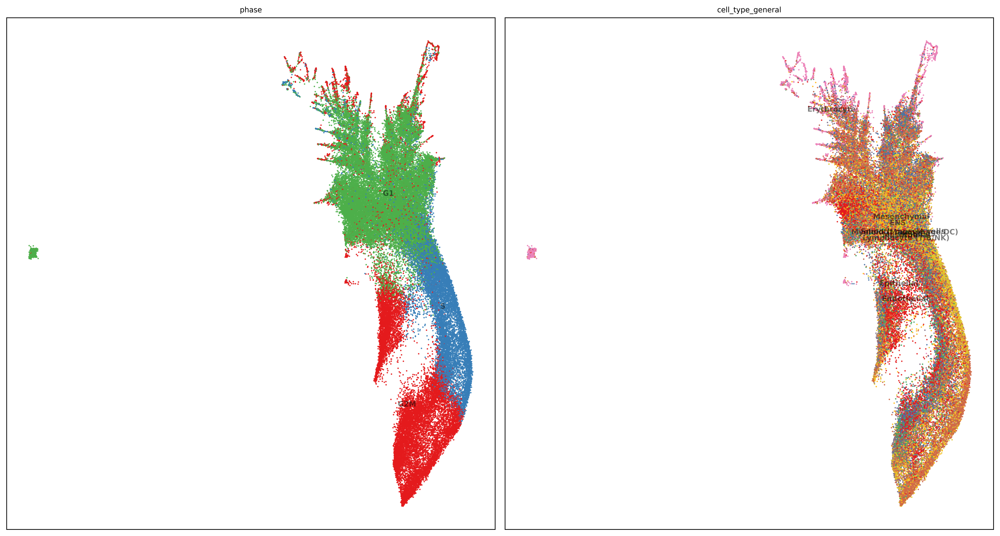

In [28]:
show_emb = 'cc_UMAP'

show_cols = ['phase', 'cell_type_general']

ccd.pl.plot_embedding(
    adata_cc, show_emb, show_cols, figsize=(15,8), dpi=600, ncols=2, font_size=8, point_size=10, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)

# PCA and UMAP in the cc gene space of each cell type (Panel D)

Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata.obsm['cc_PCA']
Concord - INFO - PCA performed on source data with 30 components
Concord - INFO - PCA embedding stored in adata

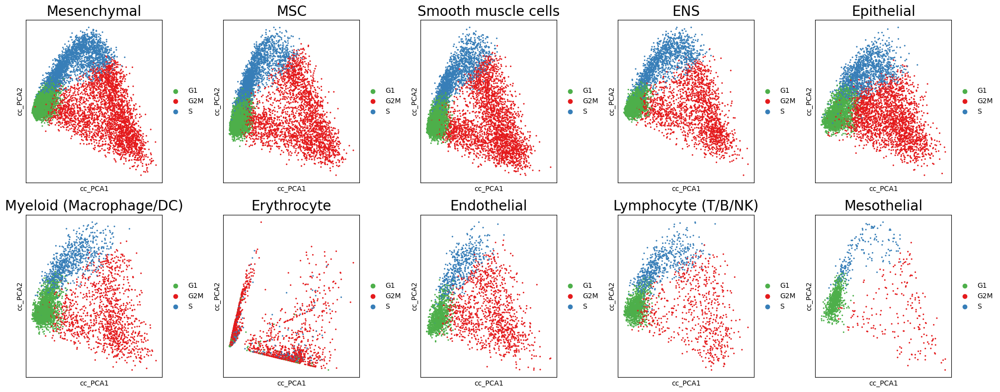

In [30]:
show_emb = 'cc_PCA'

show_cols = ['phase']

# check the PCA results in the cc gene space for the 10 cell types

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata_cc.obs['cell_type_general'].value_counts())):
    
    cell_type = adata_cc.obs['cell_type_general'].value_counts().index[i]
    adata_sub = adata_cc[adata_cc.obs['cell_type_general'] == cell_type].copy()

    # run PCA on the adata_cc
    ccd.ul.run_pca(adata_sub, source_key = 'X', result_key='cc_PCA', n_pc=30, random_state=seed)

    sc.pl.embedding(adata_sub, basis='cc_PCA', color='phase', ax=axs[i], show=False, s=20)

    axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir / f"embeddings_{show_emb}_per_cell_type_{file_suffix}.png", dpi=600)

plt.show()

Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']
Concord - INFO - UMAP embedding stored in adata.obsm['cc_UMAP']


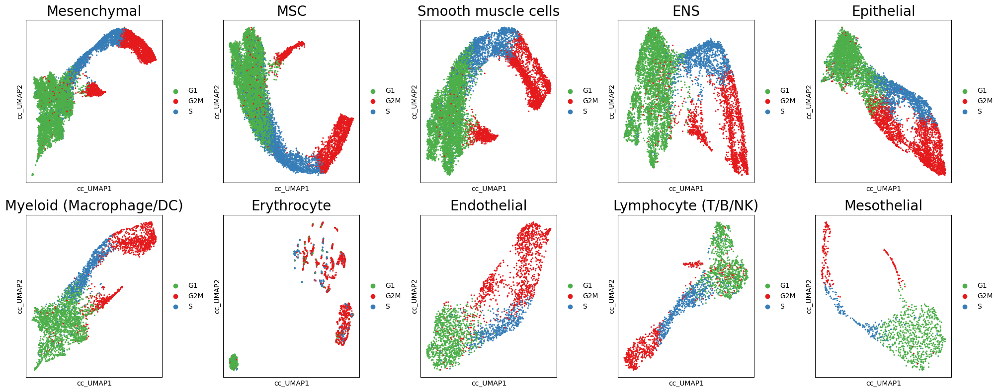

In [31]:
show_emb = 'cc_UMAP'

show_cols = ['phase']

# check the UMAP results in the cc gene space for the 10 cell types

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata_cc.obs['cell_type_general'].value_counts())):
        
        cell_type = adata_cc.obs['cell_type_general'].value_counts().index[i]
        adata_sub = adata_cc[adata_cc.obs['cell_type_general'] == cell_type].copy()
    
        # run UMAP on the adata_cc
        ccd.ul.run_umap(adata_sub, source_key = 'cc_PCA', result_key='cc_UMAP', random_state=seed)
    
        sc.pl.embedding(adata_sub, basis='cc_UMAP', color='phase', ax=axs[i], show=False, s=20)
    
        axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir / f"embeddings_{show_emb}_per_cell_type_{file_suffix}.png", dpi=600)

plt.show()


# Select the cell cycle most and least related neurons in the Concord latent

In [39]:
# compute the correlation between the S_score and the 32 nodes in Concord latent
corrs_S = []
for i in range(32):
    corr = np.corrcoef(adata.obs['S_score'], adata.obsm['Concord'][:, i])[0, 1]
    corrs_S.append(corr)
corrs_S = np.array(corrs_S)

# compute the correlation between the G2M_score and the 32 nodes in Concord latent
corrs_G2M = []
for i in range(32):
    corr = np.corrcoef(adata.obs['G2M_score'], adata.obsm['Concord'][:, i])[0, 1]
    corrs_G2M.append(corr)  
corrs_G2M = np.array(corrs_G2M)

# create a dataframe to store the correlation between the S_score, G2M_score and the 32 nodes in Concord latent
corrs_df = pd.DataFrame({'node_index': range(32), 'S_score': corrs_S, 'G2M_score': corrs_G2M})

# rank the nodes based on the correlation with the sum of S_score abusolute value and G2M_score absolute value
corrs_df['(G2M-S)_score'] = corrs_df['G2M_score'] - corrs_df['S_score']
# corrs_df = corrs_df.sort_values('(G2M-S)_score', ascending=False)

In [40]:
# pick the top nodes with the highest S_score, G2M_score, and abs((G2M-S)_score), threshold  = 0.5
top_threshold = 0.4
top_nodes = corrs_df[(corrs_df['S_score'].abs() > top_threshold) | (corrs_df['G2M_score'].abs() > top_threshold) | (corrs_df['(G2M-S)_score'].abs() > top_threshold)]
top_nodes_index = top_nodes['node_index'].values

# # pick the bottom nodes with the lowest S_score, G2M_score, and abs((G2M-S)_score), threshold  = 0.5
bottom_threshold = 0.2
bottom_nodes = corrs_df[(corrs_df['S_score'].abs() < bottom_threshold) & (corrs_df['G2M_score'].abs() < bottom_threshold) & (corrs_df['(G2M-S)_score'].abs() < bottom_threshold)]
bottom_nodes_index = bottom_nodes['node_index'].values

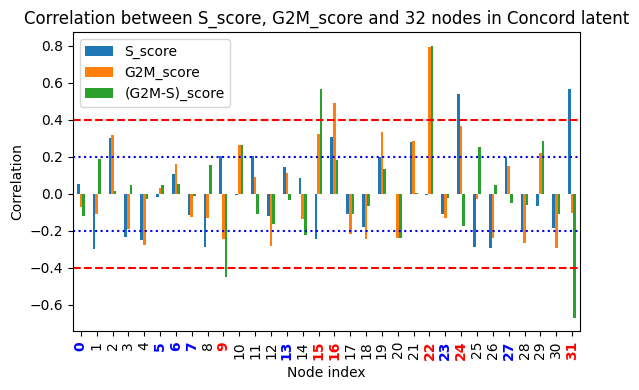

In [43]:
# barplot the correlation between the S_score, G2M_score, G2M-S_score and the 32 nodes in Concord latent
corrs_df = corrs_df.sort_values('node_index')
top_threshold = 0.4
bottom_threshold = 0.2

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
corrs_df.plot(x='node_index', y=['S_score', 'G2M_score', '(G2M-S)_score'], kind='bar', ax=ax)
# plot the threshold lines
plt.axhline(y=top_threshold, color='r', linestyle='--')
plt.axhline(y=-top_threshold, color='r', linestyle='--')
plt.axhline(y=bottom_threshold, color='b', linestyle=':')
plt.axhline(y=-bottom_threshold, color='b', linestyle=':')
plt.ylabel('Correlation')
plt.xlabel('Node index')
plt.title('Correlation between S_score, G2M_score and 32 nodes in Concord latent')

# highlight the top nodes' xticks
for i in range(len(top_nodes_index)):
    ax.get_xticklabels()[top_nodes_index[i]].set_color('r')
    ax.get_xticklabels()[top_nodes_index[i]].set_fontweight('bold')

# highlight the bottom nodes' xticks
for i in range(len(bottom_nodes_index)):
    ax.get_xticklabels()[bottom_nodes_index[i]].set_color('b')
    ax.get_xticklabels()[bottom_nodes_index[i]].set_fontweight('bold')

plt.tight_layout()

# PCA based on specific neurons of the Concord latent: either cc most related or least related

In [44]:
adata.obsm['Concord_top'] = adata.obsm['Concord'][:, top_nodes_index]
adata.obsm['Concord_bottom'] = adata.obsm['Concord'][:, bottom_nodes_index]

Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_top_PCA']


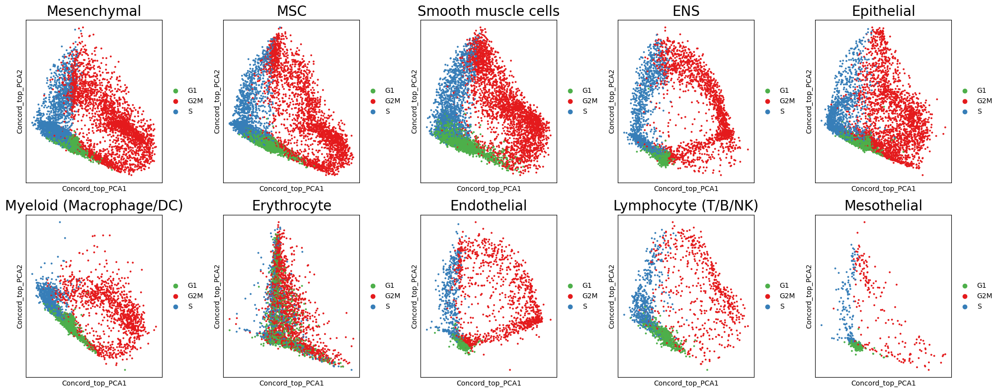

In [48]:
# run PCA on the whole Concord_top latent
ccd.ul.run_pca(adata, source_key='Concord_top', result_key='Concord_top_PCA', n_pc=3, random_state=seed)

# plot the PCA results for 10 cell types based on the top cc related Concord neurons

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
    
    cell_type = adata.obs['cell_type_general'].value_counts().index[i]
    adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()

    sc.pl.embedding(adata_sub, basis='Concord_top_PCA', color='phase', ax=axs[i], show=False, s=30)
    
    axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir/f"Concord_top_PCA_cell_types_{file_suffix}.png", dpi=600)
plt.show()

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_top_UMAP']


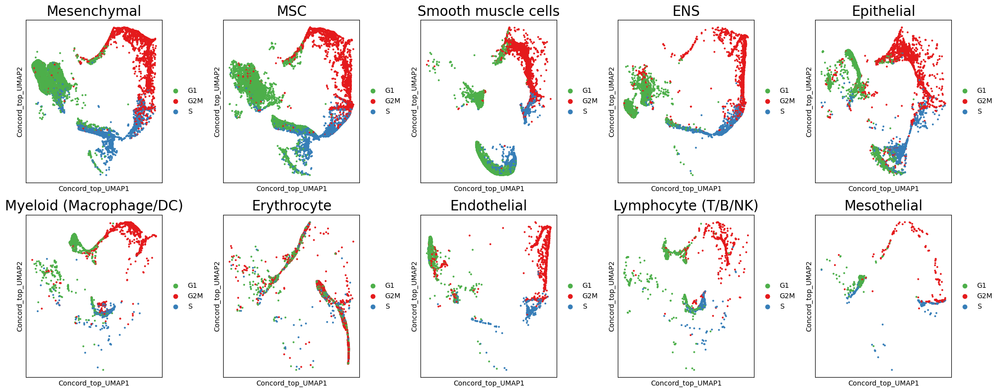

In [51]:
# run UMAP on the whole Concord_top latent
ccd.ul.run_umap(adata, source_key='Concord_top', result_key='Concord_top_UMAP', random_state=seed)

# plot the UMAP results for 10 cell types based on the top cc related Concord neurons

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
        
        cell_type = adata.obs['cell_type_general'].value_counts().index[i]
        adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()
    
        sc.pl.embedding(adata_sub, basis='Concord_top_UMAP', color='phase', ax=axs[i], show=False, s=30)
        
        axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir/f"Concord_top_UMAP_cell_types_{file_suffix}.png", dpi=600)
plt.show()

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_top_UMAP']


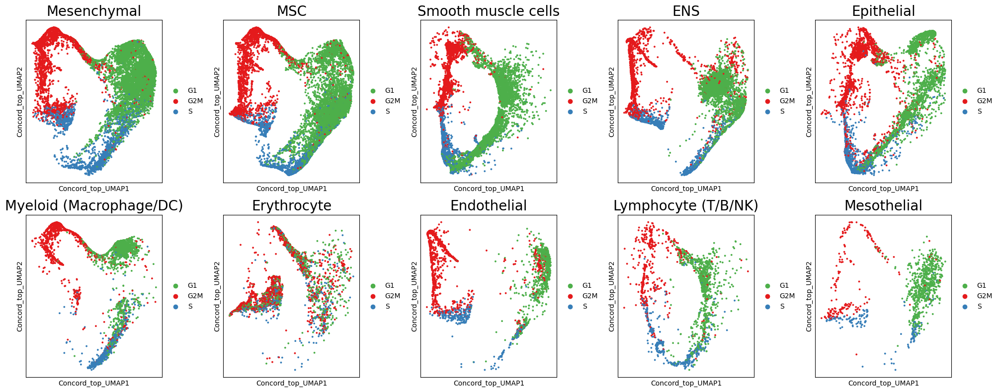

In [52]:
# run UMAP on the whole Concord_top latent
ccd.ul.run_umap(adata, source_key='Concord_top_PCA', result_key='Concord_top_UMAP', random_state=seed)

# plot the UMAP results for 10 cell types based on the top cc related Concord neurons

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
        
        cell_type = adata.obs['cell_type_general'].value_counts().index[i]
        adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()
    
        sc.pl.embedding(adata_sub, basis='Concord_top_UMAP', color='phase', ax=axs[i], show=False, s=30)
        
        axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir/f"Concord_top_PCAtoUMAP_cell_types_{file_suffix}.png", dpi=600)
plt.show()

Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on source data with 3 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_bottom_PCA']
Concord - INFO - PCA performed on 

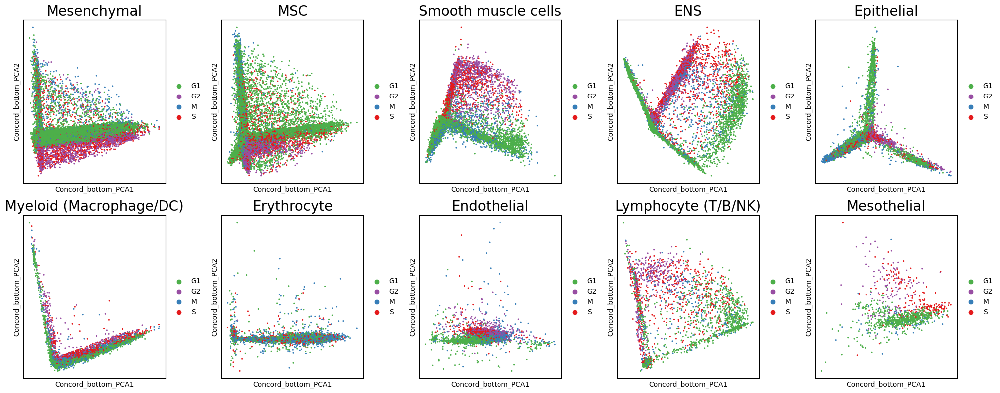

In [53]:
# run PCA on the bottom neurons of Concord latent, and plot the PCA results for 10 cell types

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
    
    cell_type = adata.obs['cell_type_general'].value_counts().index[i]
    adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()

    ccd.ul.run_pca(adata_sub, source_key='Concord_bottom', result_key='Concord_bottom_PCA', n_pc=3, random_state=seed)

    sc.pl.embedding(adata_sub, basis='Concord_bottom_PCA', color='refined_phase', ax=axs[i], show=False, s=20)

    axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir/f"Concord_bottom_PCA_cell_types_{file_suffix}.png", dpi=600)
plt.show()

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_bottom_UMAP']


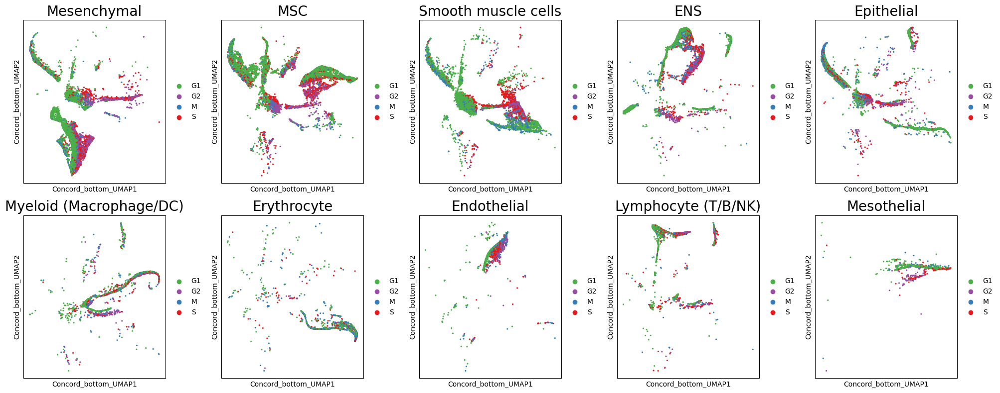

In [54]:
# run UMAP on the whole Concord_top latent
ccd.ul.run_umap(adata, source_key='Concord_bottom', result_key='Concord_bottom_UMAP', random_state=seed)

# plot the UMAP results for 10 cell types, the UMAP is based on the whole Concord latent

fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()

for i in range(len(adata.obs['cell_type_general'].value_counts())):
    
    cell_type = adata.obs['cell_type_general'].value_counts().index[i]
    adata_sub = adata[adata.obs['cell_type_general'] == cell_type].copy()

    sc.pl.embedding(adata_sub, basis='Concord_bottom_UMAP', color='refined_phase', ax=axs[i], show=False, s=20)
    
    axs[i].set_title(adata.obs['cell_type_general'].value_counts().index[i], fontsize=20)
plt.tight_layout()

plt.savefig(save_dir/f"Concord_bottom_UMAP_cell_types_{file_suffix}.png", dpi=600)
plt.show()